In [361]:
import pandas as pd
import numpy as np
import skfuzzy as fuzz
from skfuzzy import control as ctrl
from sklearn.model_selection import train_test_split
from PIL import Image, ImageOps, ImageEnhance, ImageFilter
import cv2
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from keras import regularizers
from tensorflow.keras.utils import to_categorical
from deap import base, creator, tools, algorithms
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix
import shap
import lime
import lime.lime_tabular
import seaborn as sns
import random



# Create Dataset

### Process Images

In [362]:
SIZE = 126

def resize_and_center(sample, new_size=126):
    inv_sample = ImageOps.invert(sample)
    bbox = inv_sample.getbbox()
    crop = inv_sample.crop(bbox)
    delta_w = new_size - crop.size[0]
    delta_h = new_size - crop.size[1]
    padding = (delta_w // 2, delta_h // 2, delta_w - (delta_w // 2), delta_h - (delta_h // 2))
    return ImageOps.expand(crop, padding)

In [363]:
def process_image(filename, desired_num_samples=10):
    image = Image.open(filename)
    bw_image = image.convert(mode='L')
    bw_image = ImageEnhance.Contrast(bw_image).enhance(1.5)
    step_size = bw_image.height / desired_num_samples
    samples = []

    for i in range(desired_num_samples):
        y = int(i * step_size)
        cuts = []
        for x in range(0, bw_image.width - SIZE + 1, SIZE):
            cut = bw_image.crop(box=(x, y, x + SIZE, y + SIZE))
            cuts.append(cut)
        samples.append(cuts)

    resized_samples = []
    for row in samples:
        resized_samples.append([resize_and_center(sample) for sample in row])

    return resized_samples

In [364]:
filenames_per_person = [
    ["Dataset/yeeern-1.png", "Dataset/yeeern-2.png", "Dataset/yeeern-3.png"],
    ["Dataset/jason-1.jpg", "Dataset/jason-2.jpg", "Dataset/jason-3.jpg"],
    ["Dataset/junchuan-1.png", "Dataset/junchuan-2.png", "Dataset/junchuan-3.png"],
    ["Dataset/rachel-1.png", "Dataset/rachel-2.png", "Dataset/rachel-3.png"]
]

all_resized_samples = []
class_labels = ["Yee Ern", "Jason", "Jun Chuan", "Rachel"]

for person_index, person_files in enumerate(filenames_per_person):
    for filename in person_files:
        resized_samples = process_image(filename)
        all_resized_samples.extend(resized_samples)




In [365]:
# Resize images to (28, 28) and convert to grayscale
resized_samples = []
for row in all_resized_samples:
    resized_row = []
    for sample in row:
        # Resize each sample to (28, 28)
        resized_sample = sample.resize((28, 28))
        # Convert to grayscale if needed
        if resized_sample.mode != 'L':
            resized_sample = resized_sample.convert('L')
        resized_row.append(resized_sample)
    resized_samples.append(resized_row)

# Convert the resized images into binary samples
binary_samples = np.array([[np.array(sample.getdata()) for sample in row] for row in resized_samples])
binary_samples = binary_samples.reshape(len(resized_samples) * len(resized_samples[0]), 28, 28)

# Create class labels
classes = np.repeat(np.arange(len(filenames_per_person)), 300)  

print(f'X shape: {binary_samples.shape}')
print(f'y shape: {classes.shape}')

# Save the binary samples and classes to .npy files
xfile = 'digits_x.npy'
yfile = 'digits_y.npy'
np.save(xfile, binary_samples)
np.save(yfile, classes)


X shape: (1200, 28, 28)
y shape: (1200,)


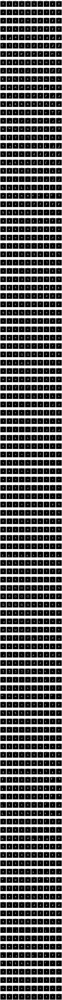

In [366]:
# Load the binary samples and classes from .npy files
binary_samples = np.load('digits_x.npy')
classes = np.load('digits_y.npy')

# Number of images to display
num_images = binary_samples.shape[0]

# Number of columns and rows for the grid
num_cols = 10
num_rows = (num_images + num_cols - 1) // num_cols  

# Create a figure for the grid with larger size
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 2))

# Loop through all the images and display them in the grid
for i, ax in enumerate(axes.flatten()):
    if i < num_images:
        ax.imshow(binary_samples[i], cmap='gray')
        ax.set_title(class_labels[classes[i]], fontsize=10)  
        ax.axis('off')
        ax.set_aspect('equal')  
    else:
        fig.delaxes(ax)

plt.tight_layout()  
plt.show()


Shape of binary_samples: (1200, 28, 28)
Data type of binary_samples: int32
Shape of classes: (1200,)
Data type of classes: int32


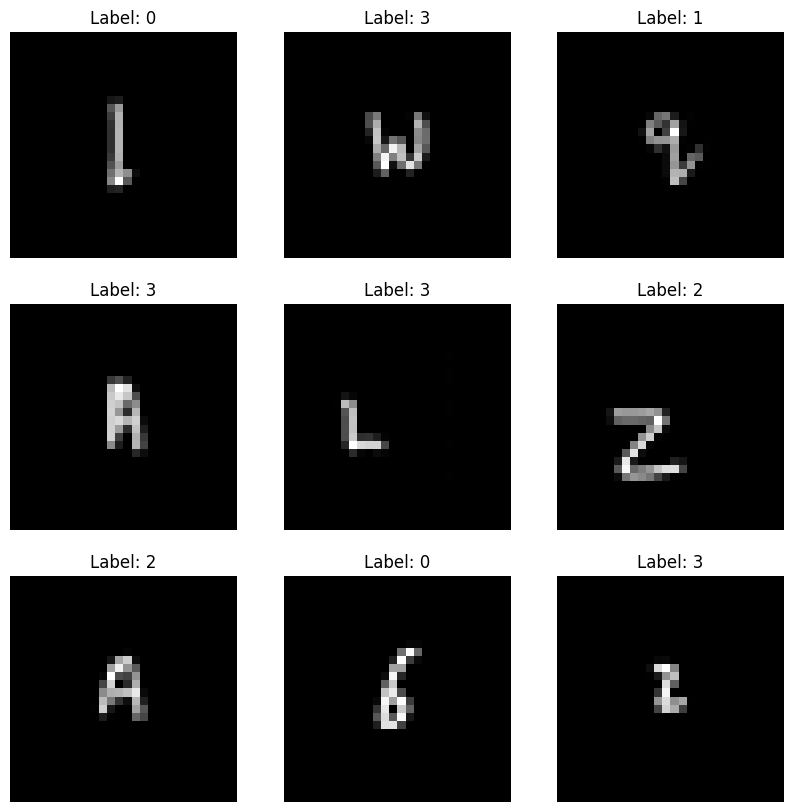

In [367]:
# Load the data
xfile = 'digits_x.npy'
yfile = 'digits_y.npy'
binary_samples = np.load(xfile)
classes = np.load(yfile)

# Inspect the data
print("Shape of binary_samples:", binary_samples.shape)
print("Data type of binary_samples:", binary_samples.dtype)
print("Shape of classes:", classes.shape)
print("Data type of classes:", classes.dtype)

# Display some sample images
def show_samples(images, labels, num_samples=9):
    fig, axes = plt.subplots(3, 3, figsize=(10, 10))
    indices = np.random.choice(len(images), num_samples, replace=False)
    for i, idx in enumerate(indices):
        ax = axes[i // 3, i % 3]
        ax.imshow(images[idx], cmap='gray')
        ax.set_title(f"Label: {labels[idx]}")
        ax.axis('off')
    plt.show()

# Assuming binary_samples contains images and classes contains corresponding labels
show_samples(binary_samples, classes)

In [435]:
class_labels = ["Yee Ern", "Jason", "Jun Chuan", "Rachel"]

# Index to class mapping
index_to_class = {i: class_label for i, class_label in enumerate(class_labels)}

# Class to index mapping
class_to_index = {class_label: i for i, class_label in enumerate(class_labels)}

In [369]:
import numpy as np

# Load the data
binary_samples = np.load('digits_x.npy')
classes = np.load('digits_y.npy')

# Check the original shape of the data
print("Original shape of binary_samples:", binary_samples.shape)

# If the data is 2D images, flatten each image
# For example, if binary_samples is (num_samples, height, width)
if len(binary_samples.shape) == 3:  # assuming the shape is (num_samples, height, width)
    num_samples, height, width = binary_samples.shape
    num_features = height * width
    binary_samples_flat = binary_samples.reshape(num_samples, num_features)
else:
    binary_samples_flat = binary_samples  # assume it's already flattened

# Print the number of features
print("Number of features:", binary_samples_flat.shape[1])


Original shape of binary_samples: (1200, 28, 28)
Number of features: 784


In [370]:
import cv2
import skfuzzy as fuzz
from skfuzzy import control as ctrl

xfile = 'digits_x.npy'
yfile = 'digits_y.npy'
binary_samples = np.load(xfile)
classes = np.load(yfile)

# Function to preprocess the image
def preprocess_image(image):
    return (image > 0).astype(np.uint8)

# Calculate stroke thickness
def calculate_stroke_thickness(binary_image):
    dist_transform = cv2.distanceTransform(binary_image, cv2.DIST_L2, 5)
    return np.mean(dist_transform)

# Calculate the number of strokes
def calculate_number_of_strokes(binary_image):
    num_labels, labels_im = cv2.connectedComponents(binary_image)
    return num_labels - 1  # subtract 1 for the background

# Calculate line straightness
def calculate_line_straightness(binary_image):
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return 0
    total_length = sum(cv2.arcLength(cnt, True) for cnt in contours)
    return total_length

# Calculate loop size
def calculate_loop_size(binary_image):
    contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    loop_sizes = []
    for cnt in contours:
        area = cv2.contourArea(cnt)
        perimeter = cv2.arcLength(cnt, True)
        if perimeter == 0:
            loop_sizes.append(0)
        else:
            loop_sizes.append(area / perimeter)
    return np.mean(loop_sizes)

# Define the function to calculate aspect ratio
def calculate_aspect_ratio(binary_sample):
    contours, _ = cv2.findContours(binary_sample.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return 0  # Return 0 if no contour found
    x, y, w, h = cv2.boundingRect(contours[0])
    return w / h

# Define the function to calculate density
def calculate_density(binary_sample):
    return np.sum(binary_sample) / binary_sample.size

# Define the function to calculate Euler number
def calculate_euler_number(binary_sample):
    _, bw_image = cv2.threshold(binary_sample.astype(np.uint8), 128, 255, cv2.THRESH_BINARY)
    num_labels, _, stats, _ = cv2.connectedComponentsWithStats(bw_image, connectivity=8)
    return num_labels - (stats.shape[0] - 1)

In [371]:
# Define the fuzzy variables for feature extraction
stroke_thickness = ctrl.Antecedent(np.arange(0, 256, 1), 'stroke_thickness')
number_of_strokes = ctrl.Antecedent(np.arange(0, 51, 1), 'number_of_strokes')
line_straightness = ctrl.Antecedent(np.arange(0, 1.01, 0.01), 'line_straightness')
loop_size = ctrl.Antecedent(np.arange(0, 100, 1), 'loop_size')
aspect_ratio = ctrl.Antecedent(np.arange(0, 2.1, 0.1), 'aspect_ratio')
density = ctrl.Antecedent(np.arange(0, 1.1, 0.1), 'density')
euler_number = ctrl.Antecedent(np.arange(0, 10.1, 0.1), 'euler_number')

# Define the consequent fuzzy variable
extracted_feature = ctrl.Consequent(np.arange(0, 256, 1), 'extracted_feature')

# Define membership functions for stroke thickness
stroke_thickness['thin'] = fuzz.trimf(stroke_thickness.universe, [0, 50, 100])  # Thin strokes
stroke_thickness['medium'] = fuzz.trimf(stroke_thickness.universe, [75, 125, 175])  # Medium strokes
stroke_thickness['thick'] = fuzz.trimf(stroke_thickness.universe, [150, 200, 255])  # Thick strokes

# Define membership functions for number of strokes
number_of_strokes['few'] = fuzz.trimf(number_of_strokes.universe, [0, 10, 20])  # Few strokes
number_of_strokes['moderate'] = fuzz.trimf(number_of_strokes.universe, [15, 25, 35])  # Moderate strokes
number_of_strokes['many'] = fuzz.trimf(number_of_strokes.universe, [30, 40, 50])  # Many strokes

# Define membership functions for line straightness
line_straightness['low'] = fuzz.trimf(line_straightness.universe, [0, 0.3, 0.6])  # Low straightness
line_straightness['medium'] = fuzz.trimf(line_straightness.universe, [0.4, 0.7, 1])  # Medium straightness
line_straightness['high'] = fuzz.trimf(line_straightness.universe, [0.8, 0.9, 1])  # High straightness

# Define membership functions for loop size
loop_size['small'] = fuzz.trimf(loop_size.universe, [0, 25, 50])  # Small loops
loop_size['medium'] = fuzz.trimf(loop_size.universe, [40, 50, 60])  # Medium loops
loop_size['large'] = fuzz.trimf(loop_size.universe, [50, 75, 100])  # Large loops

# Define membership functions for aspect ratio
aspect_ratio['short'] = fuzz.trimf(aspect_ratio.universe, [0, 0.5, 1])  # Short aspect ratio
aspect_ratio['medium'] = fuzz.trimf(aspect_ratio.universe, [0.5, 1, 1.5])  # Medium aspect ratio
aspect_ratio['tall'] = fuzz.trimf(aspect_ratio.universe, [1, 1.5, 2])  # Tall aspect ratio

# Define membership functions for density
density['low'] = fuzz.trimf(density.universe, [0, 0.3, 0.6])  # Low density
density['medium'] = fuzz.trimf(density.universe, [0.4, 0.7, 1])  # Medium density
density['high'] = fuzz.trimf(density.universe, [0.8, 0.9, 1])  # High density

# Define membership functions for Euler number
euler_number['low'] = fuzz.trimf(euler_number.universe, [0, 3, 5])  # Low Euler number
euler_number['medium'] = fuzz.trimf(euler_number.universe, [4, 5, 7])  # Medium Euler number
euler_number['high'] = fuzz.trimf(euler_number.universe, [6, 7, 10])  # High Euler number

# Define membership functions for the extracted feature
extracted_feature['poor'] = fuzz.trimf(extracted_feature.universe, [0, 85, 128])  # Range [0, 128]
extracted_feature['average'] = fuzz.trimf(extracted_feature.universe, [85, 128, 170])  # Range [128, 170]
extracted_feature['good'] = fuzz.trimf(extracted_feature.universe, [128, 170, 255])  # Range [128, 255]

c:\Users\Asus\AppData\Local\Programs\Python\Python310\lib\site-packages\skfuzzy\control\fuzzyvariable.py:122: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


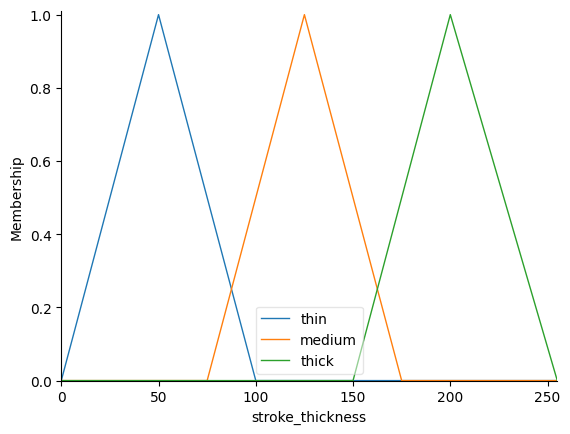

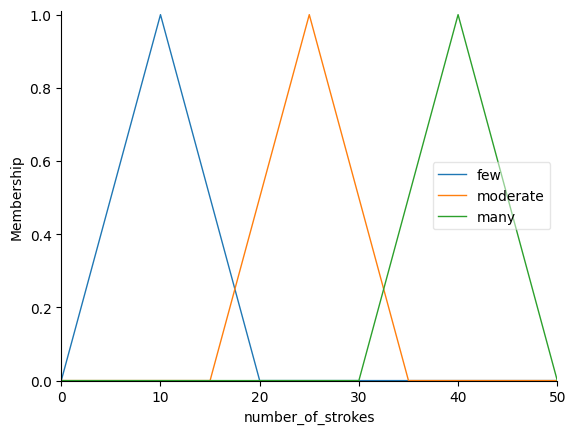

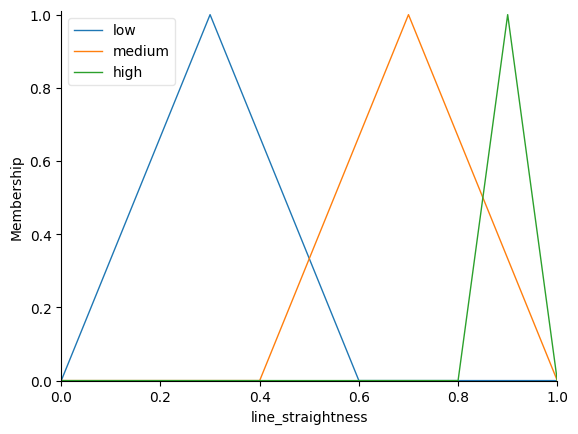

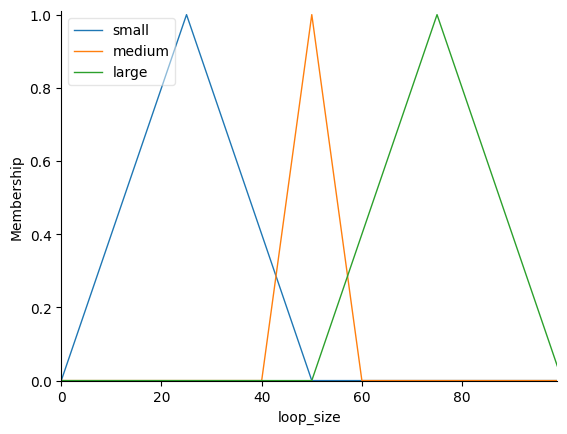

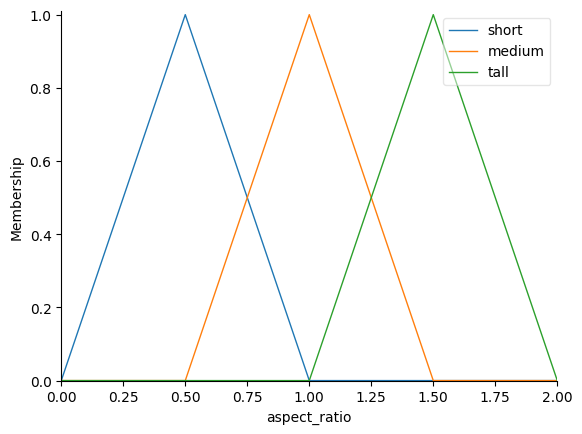

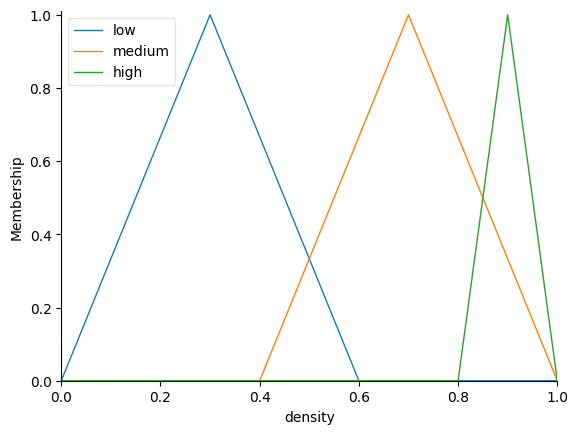

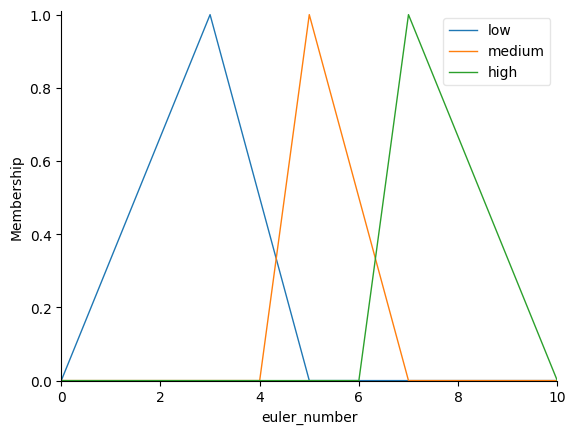

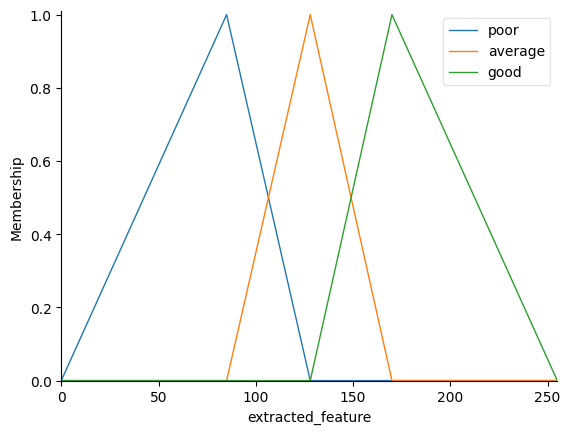

In [415]:
# Visualize membership functions
stroke_thickness.view()
number_of_strokes.view()
line_straightness.view()
loop_size.view()
aspect_ratio.view()
density.view()
euler_number.view()
extracted_feature.view()

# Display the plots
plt.show()

In [372]:
rule1 = ctrl.Rule(((density['medium'] | stroke_thickness['thin']) & (line_straightness['medium'] | number_of_strokes['many'])), extracted_feature['poor'], extracted_feature['average'])
rule2 = ctrl.Rule(((line_straightness['low'] | loop_size['small']) & (density['low'] | aspect_ratio['tall'])), extracted_feature['good'], extracted_feature['good'])
rule3 = ctrl.Rule(((stroke_thickness['medium'] | line_straightness['low']) & (number_of_strokes['moderate'] | euler_number['high'])), extracted_feature['average'])
rule4 = ctrl.Rule(((number_of_strokes['moderate'] | euler_number['high']) & (loop_size['medium'] | aspect_ratio['tall'] | density['medium']) & (stroke_thickness['thick'] | line_straightness['low'])), extracted_feature['good'])
rule5 = ctrl.Rule(((density['high'] | line_straightness['medium']) & (aspect_ratio['short'] | number_of_strokes['moderate']) & euler_number['medium']), extracted_feature['average'])
rule6 = ctrl.Rule(((stroke_thickness['medium'] & loop_size['large']) | (line_straightness['high'] & euler_number['low'] & density['low'])), extracted_feature['poor'])
rule7 = ctrl.Rule(((loop_size['medium'] | line_straightness['low'] | stroke_thickness['thick'] | density['low']) & (extracted_feature['good'] | aspect_ratio['medium'] | number_of_strokes['few'])), extracted_feature['average'])
rule8 = ctrl.Rule(((line_straightness['high'] & stroke_thickness['medium'] & number_of_strokes['many'] & density['high']) | extracted_feature['average']), extracted_feature['poor'])
rule9 = ctrl.Rule(((loop_size['small'] | stroke_thickness['medium'] | extracted_feature['average'] | aspect_ratio['medium'] | number_of_strokes['many'] | euler_number['medium'] | density['low'])), extracted_feature['poor'])
rule10 = ctrl.Rule(((line_straightness['medium'] | aspect_ratio['medium'] | euler_number['high'] | number_of_strokes['many'] | loop_size['large'])), extracted_feature['average'])


# Create fuzzy control system and simulation
fuzzy_ctrl = ctrl.ControlSystem([rule1, rule2, rule3, rule4, rule5, rule6, rule7, rule8, rule9, rule10])
fuzzy_simulation = ctrl.ControlSystemSimulation(fuzzy_ctrl)

In [373]:
def fuzzy_extract_features(image):
    # Preprocess the image
    binary_image = preprocess_image(image)
    
    # Calculate features
    stroke_thickness_value = calculate_stroke_thickness(binary_image)
    line_straightness_value = calculate_line_straightness(binary_image)
    loop_size_value = calculate_loop_size(binary_image)
    number_of_strokes_value = calculate_number_of_strokes(binary_image)
    aspect_ratio_value = calculate_aspect_ratio(binary_image)
    density_value = calculate_density(binary_image)
    euler_number_value = calculate_euler_number(binary_image)

    # Set input values for the fuzzy system simulation
    fuzzy_simulation.input['stroke_thickness'] = stroke_thickness_value
    fuzzy_simulation.input['line_straightness'] = line_straightness_value
    fuzzy_simulation.input['loop_size'] = loop_size_value
    fuzzy_simulation.input['number_of_strokes'] = number_of_strokes_value
    fuzzy_simulation.input['aspect_ratio'] = aspect_ratio_value
    fuzzy_simulation.input['density'] = density_value
    fuzzy_simulation.input['euler_number'] = euler_number_value

    # Compute fuzzy system
    fuzzy_simulation.compute()

    return [stroke_thickness_value, line_straightness_value, loop_size_value,
            number_of_strokes_value, aspect_ratio_value, density_value, euler_number_value]

In [437]:
# Initialize lists to store features and class labels
features_list = []

# Extract features and class labels for each image in the dataset using fuzzy logic
for image, label in zip(binary_samples, classes):
    features = fuzzy_extract_features(image)
    features_list.append(features)

# Convert the lists to numpy arrays
fuzzy_features = np.array(features_list)
class_labels = np.array(classes)  

# Print the shape and extracted features
print("Extracted Features Shape:", fuzzy_features.shape)
data = pd.DataFrame({
    "Fuzzy Features": fuzzy_features.tolist(),  # Convert to list to handle numpy arrays
    "Class Labels": class_labels
})

# Print the DataFrame
data

Extracted Features Shape: (1200, 7)


,Fuzzy Features,Class Labels
0,"[0.08163265138864517, 27.899494767189026, 1.88...",0
1,"[0.030612245202064514, 24.0, 0.458333333333333...",0
2,"[0.09387754648923874, 56.627416491508484, 0.70...",0
3,"[0.08494897931814194, 54.62741661071777, 0.640...",0
4,"[0.08902271091938019, 34.14213538169861, 1.230...",0
...,...,...
1195,"[0.04821429029107094, 27.313708305358887, 0.73...",3
1196,"[0.03137755021452904, 21.899494767189026, 0.57...",3
1197,"[0.04642857238650322, 27.313708305358887, 0.69...",3
1198,"[0.05076530948281288, 27.313708305358887, 0.76...",3


## Neural Network

In [438]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(fuzzy_features, class_labels, test_size=0.2, random_state=42)

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_test.shape)
print("y_test shape:", y_test.shape)


X_train shape: (960, 7)
y_train shape: (960,)
X_test shape: (240, 7)
y_test shape: (240,)


In [439]:
# Define the model architecture
model = Sequential([
    Dense(64, input_shape=(7,), activation='relu'),
    Dense(32, activation='relu'),
    Dense(16, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(4, activation='softmax') 
])


model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
history = model.fit(X_train, y_train, epochs=50, validation_split=0.2, batch_size=16)

# Evaluate the model on the test set using X_test
test_loss, test_acc = model.evaluate(X_test, y_test)

print('Test accuracy:', test_acc)

Epoch 1/50
48/48 [==============================] - 1s 7ms/step - loss: 1.5253 - accuracy: 0.2279 - val_loss: 1.7117 - val_accuracy: 0.2240
Epoch 2/50
48/48 [==============================] - 0s 4ms/step - loss: 1.4539 - accuracy: 0.2643 - val_loss: 1.3837 - val_accuracy: 0.2708
Epoch 3/50
48/48 [==============================] - 0s 4ms/step - loss: 1.4181 - accuracy: 0.3047 - val_loss: 1.3067 - val_accuracy: 0.3490
Epoch 4/50
48/48 [==============================] - 0s 4ms/step - loss: 1.3833 - accuracy: 0.3216 - val_loss: 1.3326 - val_accuracy: 0.3438
Epoch 5/50
48/48 [==============================] - 0s 4ms/step - loss: 1.3691 - accuracy: 0.3451 - val_loss: 1.2816 - val_accuracy: 0.4219
Epoch 6/50
48/48 [==============================] - 0s 4ms/step - loss: 1.3424 - accuracy: 0.3385 - val_loss: 1.2600 - val_accuracy: 0.4062
Epoch 7/50
48/48 [==============================] - 0s 4ms/step - loss: 1.3505 - accuracy: 0.3477 - val_loss: 1.2506 - val_accuracy: 0.4323
Epoch 8/50
48/48 [==

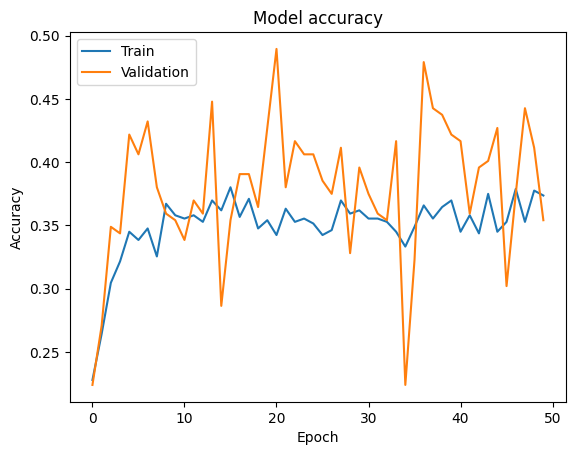

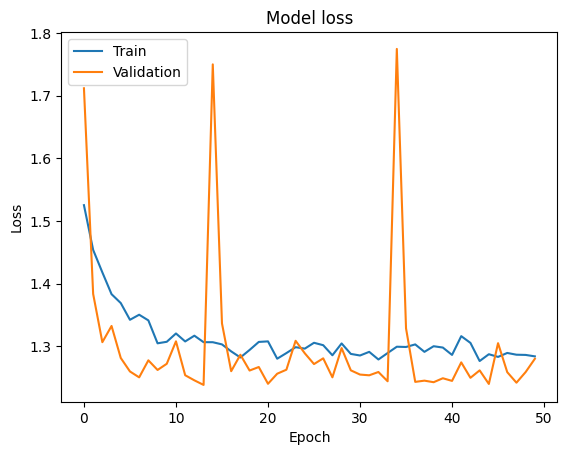

In [440]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()


8/8 [==============================] - 0s 2ms/step

Classification Report:
              precision    recall  f1-score   support

     Yee Ern       0.09      0.02      0.03        62
       Jason       0.32      0.72      0.44        60
   Jun Chuan       0.39      0.27      0.32        60
      Rachel       0.56      0.50      0.53        58

    accuracy                           0.37       240
   macro avg       0.34      0.37      0.33       240
weighted avg       0.33      0.37      0.32       240



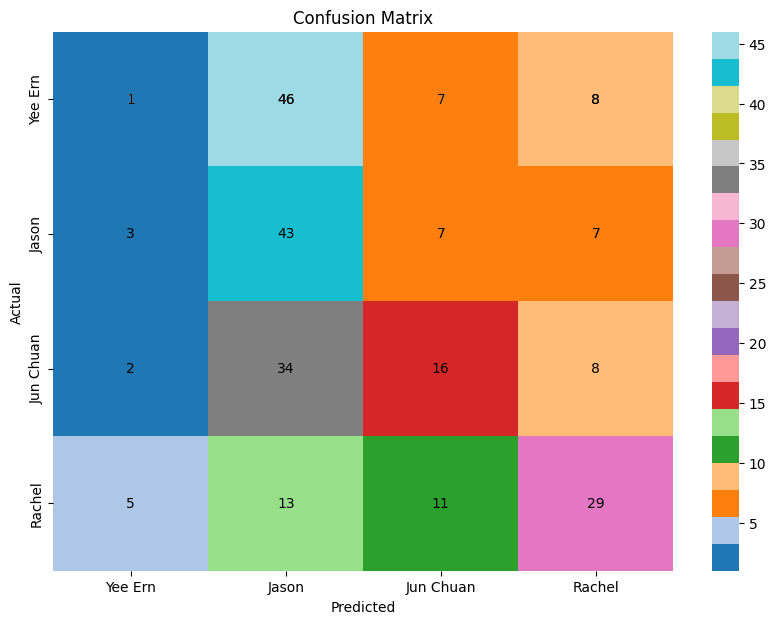

In [441]:
# Generate predictions on the test set
y_pred = np.argmax(model.predict(X_test), axis=1)

# Print classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred, target_names=class_labels))

# Construct confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Visualize Confusion Matrix with cell-wise labels
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, cmap='tab20', fmt='d', xticklabels=class_labels, yticklabels=class_labels)

# Add cell-wise labels
for i in range(len(cm)):
    for j in range(len(cm[0])):
        plt.text(j + 0.5, i + 0.5, cm[i, j], ha='center', va='center', color='Black')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [442]:
# Analyze the results
correct_indices = np.where(y_pred == y_test)[0]
incorrect_indices = np.where(y_pred != y_test)[0]

print(f"Correct predictions: {len(correct_indices)}")
print(f"Incorrect predictions: {len(incorrect_indices)}")

Correct predictions: 89
Incorrect predictions: 151


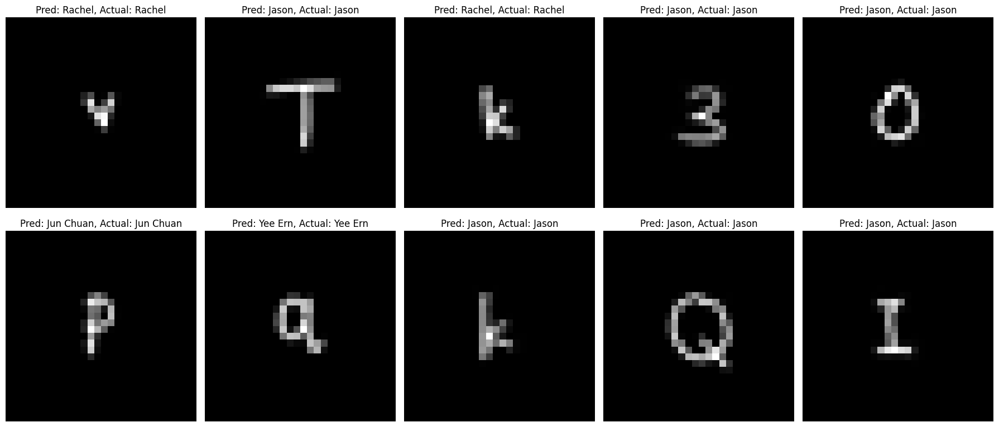

In [443]:
# Assuming X_images contains the original images corresponding to fuzzy_features
X_images_train, X_images_test, _, _ = train_test_split(binary_samples, classes, test_size=0.2, random_state=42)

# Display 10 examples of correct predictions
plt.figure(figsize=(18, 8))
for i, correct in enumerate(correct_indices[:10]): 
    plt.subplot(2, 5, i+1)  # Adjusting subplot layout for 10 samples
    plt.imshow(X_images_test[correct], cmap='gray')  
    plt.title(f"Pred: {index_to_class[y_pred[correct]]}, Actual: {index_to_class[y_test[correct]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()


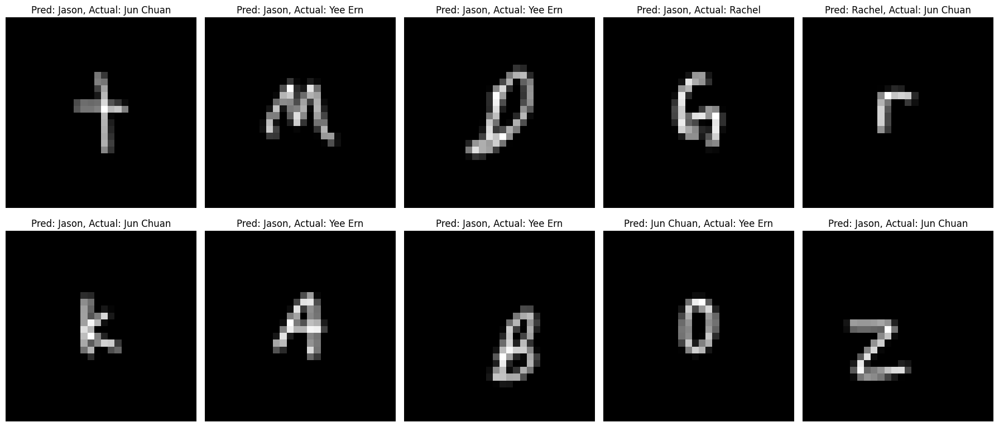

In [444]:
# Display some examples of incorrect predictions
plt.figure(figsize=(18, 8))
for i, incorrect in enumerate(incorrect_indices[:10]):
    plt.subplot(2, 5, i+1)
    plt.imshow(X_images_test[incorrect], cmap='gray') 
    plt.title(f"Pred: {index_to_class[y_pred[incorrect]]}, Actual: {index_to_class[y_test[incorrect]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [445]:
accuracy_per_class = cm.diagonal() / cm.sum(axis=1)
for i, accuracy in enumerate(accuracy_per_class):
    print(f"Accuracy for class {index_to_class[i]}: {accuracy:.2f}")

best_class_index = np.argmax(accuracy_per_class)
worst_class_index = np.argmin(accuracy_per_class)

Accuracy for class Yee Ern: 0.02
Accuracy for class Jason: 0.72
Accuracy for class Jun Chuan: 0.27
Accuracy for class Rachel: 0.50


In [446]:
print(f"Best accuracy: {index_to_class[best_class_index]} with {accuracy_per_class[best_class_index]:.2f}")
print(f"Worst accuracy: {index_to_class[worst_class_index]} with {accuracy_per_class[worst_class_index]:.2f}")

Best accuracy: Jason with 0.72
Worst accuracy: Yee Ern with 0.02


157/157 [==============================] - 0s 2ms/step


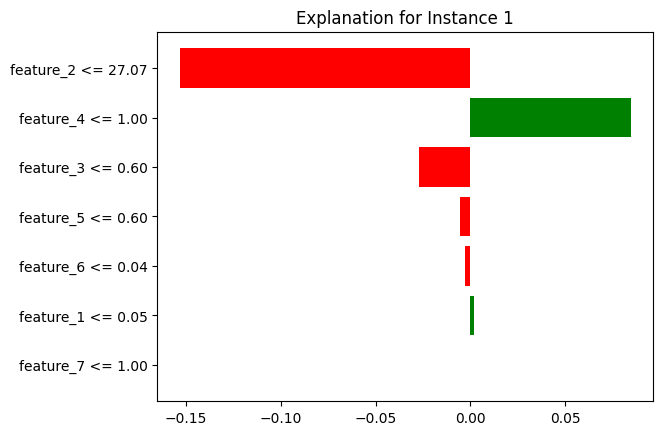

157/157 [==============================] - 0s 2ms/step


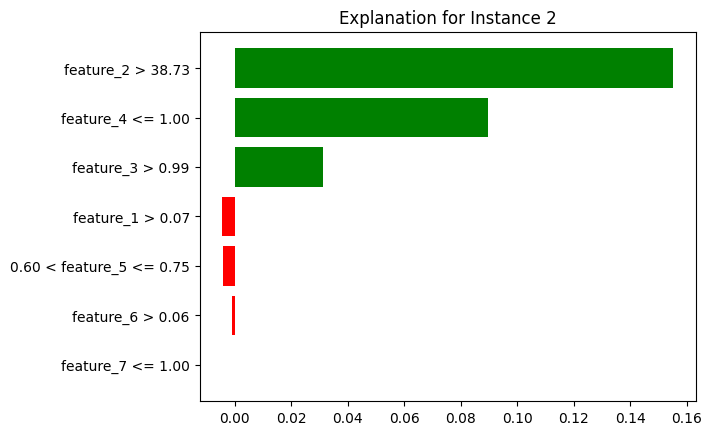

157/157 [==============================] - 0s 2ms/step


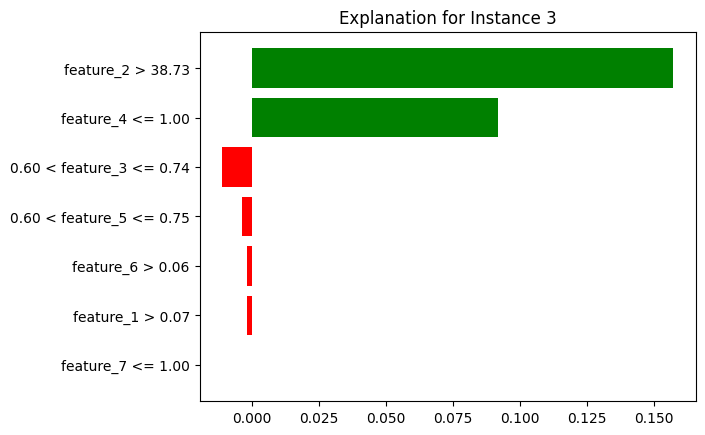

157/157 [==============================] - 0s 2ms/step


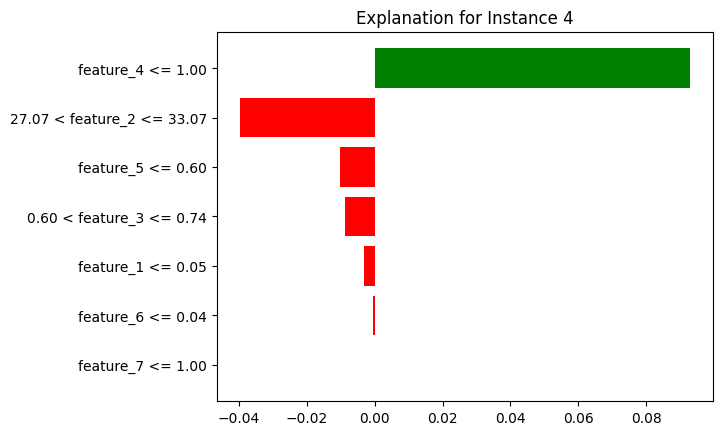

157/157 [==============================] - 0s 2ms/step


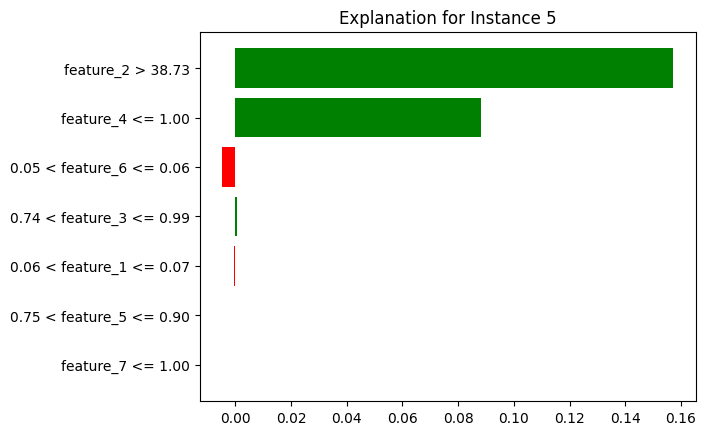

157/157 [==============================] - 0s 2ms/step


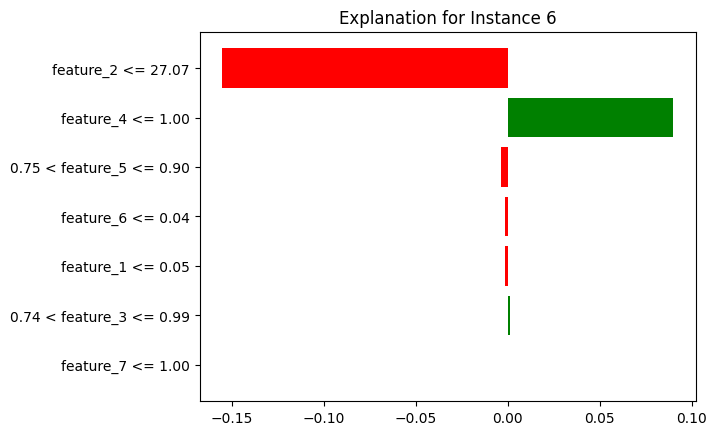

157/157 [==============================] - 0s 2ms/step


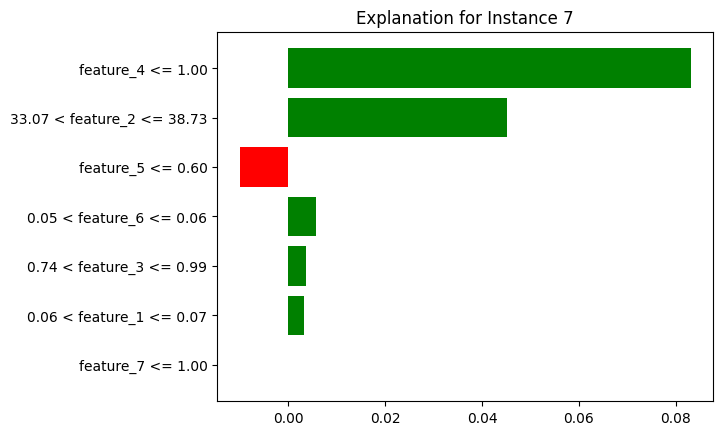

157/157 [==============================] - 0s 2ms/step


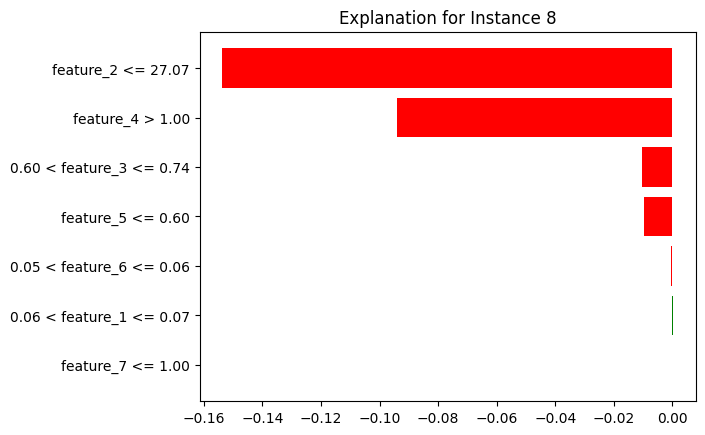

157/157 [==============================] - 0s 2ms/step


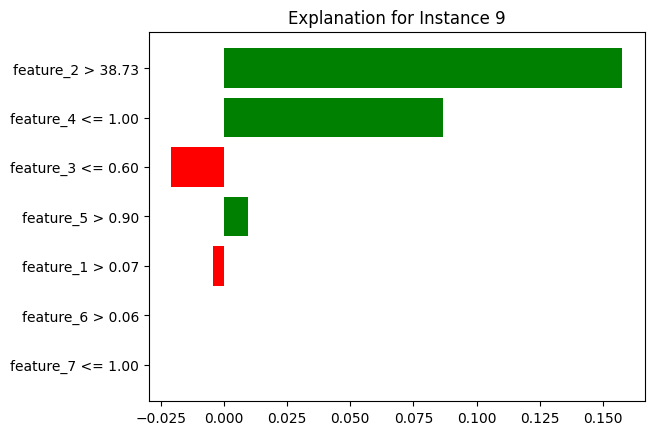

157/157 [==============================] - 0s 2ms/step


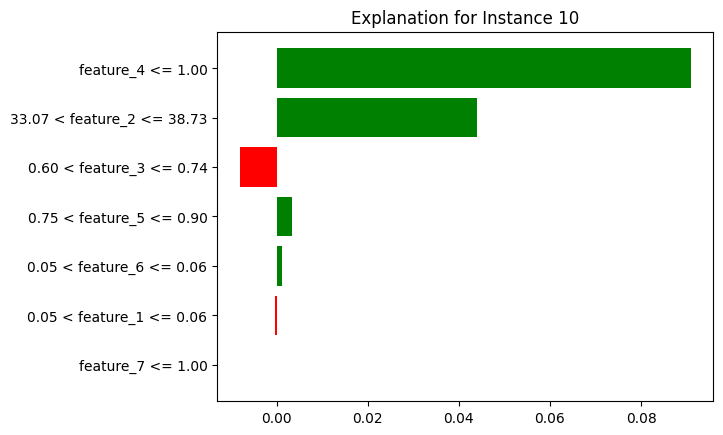

In [447]:
# Initialize the LIME tabular explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=[f'feature_{i+1}' for i in range(X_train.shape[1])],  
    class_names=["Yee Ern", "Jason", "Jun Chuan", "Rachel"],
    discretize_continuous=True
)

# Define the prediction function
def predict_fn(features):
    return model.predict(features) 

# Function to explain and visualize the explanation for a single instance
def explain_and_visualize(instance, index):
    # Explain the model's prediction on the selected instance
    explanation = explainer.explain_instance(
        instance,
        predict_fn,  # Use the prediction function of the best model
        num_features=7,  
        top_labels=5  # Number of top labels to explain
    )

    # Display the explanation
    explanation.show_in_notebook(show_all=False)
    explanation.as_pyplot_figure()
    plt.title(f'Explanation for Instance {index + 1}')
    plt.show()

for i in range(min(10, len(X_train))):
    explain_and_visualize(X_train[i], i)

## Genetic Algorithm

In [385]:
import random
from deap import base, creator, tools, algorithms


# Define the evaluation function for the neural network
def evaluate_nn(individual):
    learning_rate = individual[0]
    batch_size = int(individual[1])
    num_epochs = int(individual[2])
    num_neurons1 = int(individual[3])
    num_neurons2 = int(individual[4])
    num_neurons3 = int(individual[5])

    # Create the neural network model
    model = Sequential([
        Dense(num_neurons1, input_shape=(7,), activation='relu'),
        Dense(num_neurons2, activation='relu'),
        Dense(num_neurons3, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(4, activation='softmax') 
    ])
    model.compile(optimizer=Adam(learning_rate=learning_rate),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    # Train the model
    model.fit(X_train, y_train, epochs=num_epochs, batch_size=batch_size, verbose=0)

    # Evaluate the model
    _, accuracy = model.evaluate(X_test, y_test, verbose=0)

    # Return the accuracy as the fitness value
    return accuracy,


In [386]:
# Define neural network architecture
input_shape = (7,)  
num_classes = len(np.unique(class_labels))  

creator.create("FitnessMax", base.Fitness, weights=(1.0,))
creator.create("Individual", list, fitness=creator.FitnessMax)

toolbox = base.Toolbox()
learning_rates = [0.001, 0.01, 0.1]

# Attribute generators
toolbox.register("learning_rate", np.random.choice, learning_rates)
toolbox.register("batch_size", np.random.randint, 16, 64)
toolbox.register("num_epochs", np.random.randint, 10, 50)
toolbox.register("num_neurons1", np.random.randint, 8, 128)
toolbox.register("num_neurons2", np.random.randint, 8, 128)
toolbox.register("num_neurons3", np.random.randint, 8, 128)


c:\Users\Asus\AppData\Local\Programs\Python\Python310\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'FitnessMax' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "
c:\Users\Asus\AppData\Local\Programs\Python\Python310\lib\site-packages\deap\creator.py:185: RuntimeWarning: A class named 'Individual' has already been created and it will be overwritten. Consider deleting previous creation of that class or rename it.
  warnings.warn("A class named '{0}' has already been created and it "


In [387]:
# Structure initializers
toolbox.register("individual", tools.initCycle, creator.Individual,
                 (toolbox.learning_rate, toolbox.batch_size, toolbox.num_epochs,
                  toolbox.num_neurons1, toolbox.num_neurons2, toolbox.num_neurons3), n=1)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)

toolbox.register("evaluate", evaluate_nn)
toolbox.register("mate", tools.cxTwoPoint)
toolbox.register("mutate", tools.mutShuffleIndexes, indpb=0.1)
toolbox.register("select", tools.selTournament, tournsize=3)

In [388]:
def evolutionary_algorithm():
    random.seed(64)
    pop = toolbox.population(n=30)
    hof = tools.HallOfFame(1)

    best_fitness_per_gen = []  

    for gen in range(30): 
        offspring = algorithms.varAnd(pop, toolbox, cxpb=0.5, mutpb=0.2)
        fits = toolbox.map(toolbox.evaluate, offspring)
        for fit, ind in zip(fits, offspring):
            ind.fitness.values = fit

        hof.update(offspring)
        pop[:] = toolbox.select(offspring, len(pop))
        
        best_ind = hof[0]
        best_fitness = best_ind.fitness.values[0]
        best_fitness_per_gen.append(best_fitness)
        
        print(f"Generation {gen+1} | Best fitness (Accuracy): {best_fitness}")

        # Elitism: Keep the best individual in the next generation
        pop[0] = best_ind

    # Retrieve the best individual and its fitness across all generations
    best_individual = hof[0]
    best_fitness = best_individual.fitness.values[0]
    print("Best individual (Set of Parameters):", best_individual)
    print("Best fitness (Accuracy):", best_fitness)

    # Plot the best fitness over generations
    plt.plot(best_fitness_per_gen)
    plt.xlabel('Generation')
    plt.ylabel('Best Fitness (Accuracy)')
    plt.title('Best Fitness (Accuracy) over Generations')
    plt.show()

    return best_individual, best_fitness

Generation 1 | Best fitness (Accuracy): 0.38749998807907104
Generation 2 | Best fitness (Accuracy): 0.4208333194255829
Generation 3 | Best fitness (Accuracy): 0.4208333194255829
Generation 4 | Best fitness (Accuracy): 0.4208333194255829
Generation 5 | Best fitness (Accuracy): 0.4208333194255829
Generation 6 | Best fitness (Accuracy): 0.42916667461395264
Generation 7 | Best fitness (Accuracy): 0.42916667461395264
Generation 8 | Best fitness (Accuracy): 0.4625000059604645
Generation 9 | Best fitness (Accuracy): 0.4625000059604645
Generation 10 | Best fitness (Accuracy): 0.4625000059604645
Generation 11 | Best fitness (Accuracy): 0.4625000059604645
Generation 12 | Best fitness (Accuracy): 0.4625000059604645
Generation 13 | Best fitness (Accuracy): 0.4625000059604645
Generation 14 | Best fitness (Accuracy): 0.4625000059604645
Generation 15 | Best fitness (Accuracy): 0.4625000059604645
Generation 16 | Best fitness (Accuracy): 0.4625000059604645
Generation 17 | Best fitness (Accuracy): 0.462

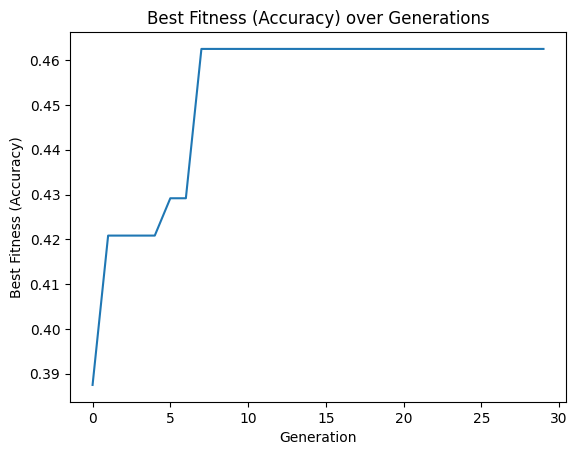

In [389]:
best_individual, best_fitness = evolutionary_algorithm()

In [458]:
print("\nBest Individual (Parameters for Neural Network):")
print(best_individual)
print("Learning Rate:", best_individual[0])
print("Batch Size:", int(best_individual[1]))
print("Number of Epochs:", int(best_individual[2]))
print("Number of Neurons in Layer 1:", int(best_individual[3]))
print("Number of Neurons in Layer 2:", int(best_individual[4]))
print("Number of Neurons in Layer 3:", int(best_individual[5]))


Best Individual (Parameters for Neural Network):
[0.001, 29, 48, 47, 63, 33]
Learning Rate: 0.001
Batch Size: 29
Number of Epochs: 48
Number of Neurons in Layer 1: 47
Number of Neurons in Layer 2: 63
Number of Neurons in Layer 3: 33


## Neural Network after Genetic Algorithm

In [391]:
learning_rate = best_individual[0]
batch_size = int(best_individual[1])
num_epochs = int(best_individual[2])
num_neurons1 = int(best_individual[3])
num_neurons2 = int(best_individual[4])
num_neurons3 = int(best_individual[5])

# Create the neural network model
ga_model = Sequential([
        Dense(num_neurons1, input_shape=(7,), activation='relu'),
        Dense(num_neurons2, activation='relu'),
        Dense(num_neurons3, activation='relu'),
        BatchNormalization(),
        Dropout(0.3),
        Dense(4, activation='softmax') 
    ])
ga_model.compile(optimizer=Adam(learning_rate=learning_rate),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

In [392]:
optimise = ga_model.fit(X_train, y_train, epochs=50, validation_split=0.2, batch_size=16)

# Evaluate the ga model
test_loss, test_acc = ga_model.evaluate(X_test, y_test)
print('Test accuracy:', test_acc)

Epoch 1/50
48/48 [==============================] - 1s 7ms/step - loss: 1.4955 - accuracy: 0.3711 - val_loss: 2.1899 - val_accuracy: 0.2188
Epoch 2/50
48/48 [==============================] - 0s 5ms/step - loss: 1.4289 - accuracy: 0.3021 - val_loss: 1.4515 - val_accuracy: 0.2865
Epoch 3/50
48/48 [==============================] - 0s 4ms/step - loss: 1.3838 - accuracy: 0.3372 - val_loss: 1.5176 - val_accuracy: 0.2396
Epoch 4/50
48/48 [==============================] - 0s 3ms/step - loss: 1.4097 - accuracy: 0.3281 - val_loss: 1.4442 - val_accuracy: 0.2656
Epoch 5/50
48/48 [==============================] - 0s 3ms/step - loss: 1.3582 - accuracy: 0.3529 - val_loss: 1.3116 - val_accuracy: 0.3854
Epoch 6/50
48/48 [==============================] - 0s 3ms/step - loss: 1.3565 - accuracy: 0.3424 - val_loss: 1.3257 - val_accuracy: 0.4115
Epoch 7/50
48/48 [==============================] - 0s 4ms/step - loss: 1.3398 - accuracy: 0.3529 - val_loss: 1.3150 - val_accuracy: 0.4010
Epoch 8/50
48/48 [==

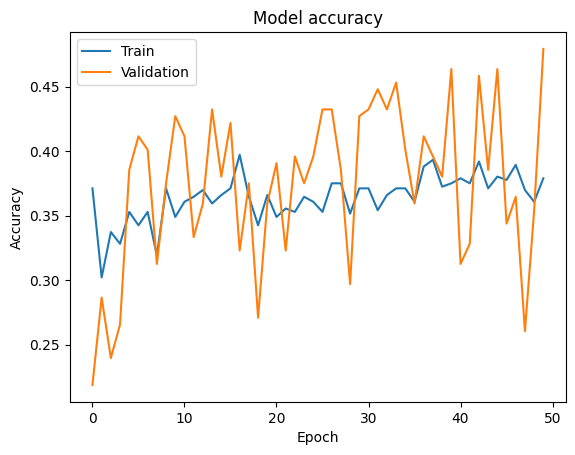

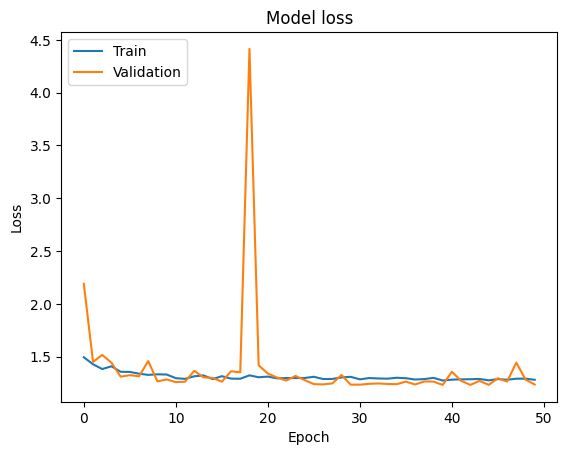

In [394]:
# Plot training & validation accuracy values
plt.plot(optimise.history['accuracy'])
plt.plot(optimise.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(optimise.history['loss'])
plt.plot(optimise.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

8/8 [==============================] - 0s 2ms/step

Classification Report:
              precision    recall  f1-score   support

     Yee Ern       0.38      0.29      0.33        62
       Jason       0.34      0.47      0.39        60
   Jun Chuan       0.00      0.00      0.00        60
      Rachel       0.44      0.84      0.58        58

    accuracy                           0.40       240
   macro avg       0.29      0.40      0.33       240
weighted avg       0.29      0.40      0.32       240



c:\Users\Asus\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Asus\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
c:\Users\Asus\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1334: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, mo

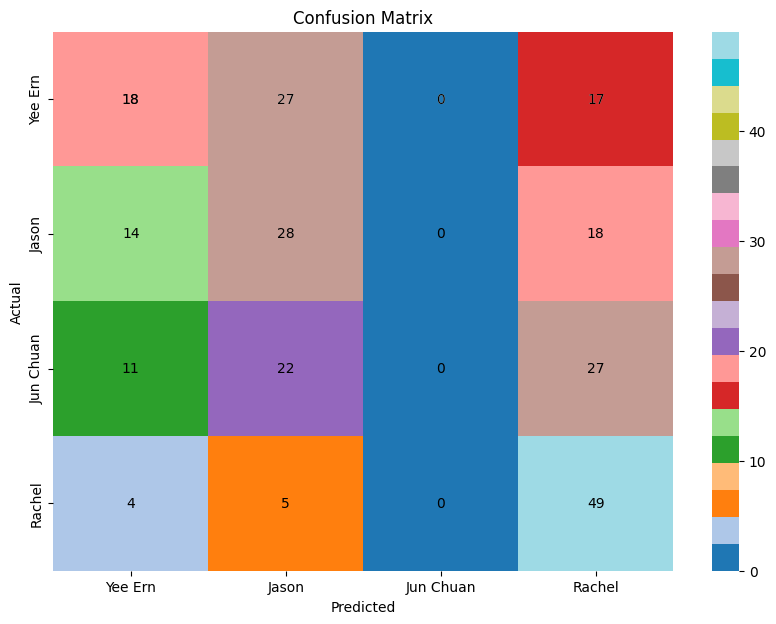

In [450]:
# Generate predictions on the test set
y_pred = np.argmax(ga_model.predict(X_test), axis=1)

# Print classification report
print("\nClassification Report:")
print(classification_report(y_test, y_pred, target_names=class_labels))

# Construct confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Visualize Confusion Matrix with cell-wise labels
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, cmap='tab20', fmt='d', xticklabels=class_labels, yticklabels=class_labels)

# Add cell-wise labels
for i in range(len(cm)):
    for j in range(len(cm[0])):
        plt.text(j + 0.5, i + 0.5, cm[i, j], ha='center', va='center', color='Black')

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

In [451]:
# Analyze the results
correct_indices = np.where(y_pred == y_test)[0]
incorrect_indices = np.where(y_pred != y_test)[0]

print(f"Correct predictions: {len(correct_indices)}")
print(f"Incorrect predictions: {len(incorrect_indices)}")

Correct predictions: 95
Incorrect predictions: 145


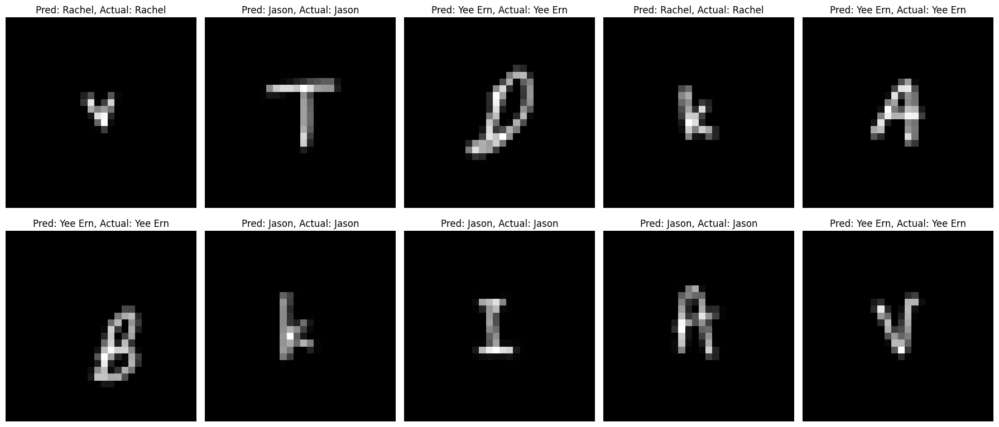

In [452]:
# Assuming X_images contains the original images corresponding to fuzzy_features
X_images_train, X_images_test, _, _ = train_test_split(binary_samples, classes, test_size=0.2, random_state=42)

# Display 10 examples of correct predictions
plt.figure(figsize=(18, 8))
for i, correct in enumerate(correct_indices[:10]): 
    plt.subplot(2, 5, i+1)  # Adjusting subplot layout for 10 samples
    plt.imshow(X_images_test[correct], cmap='gray')  
    plt.title(f"Pred: {index_to_class[y_pred[correct]]}, Actual: {index_to_class[y_test[correct]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

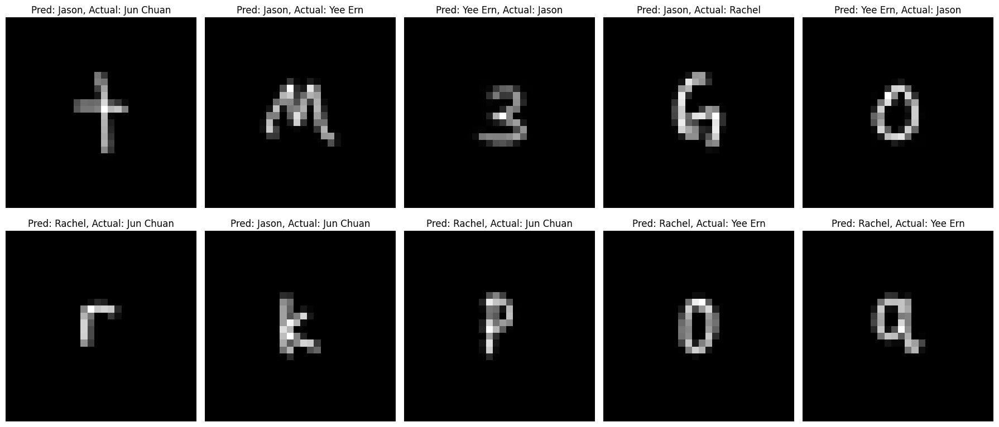

In [453]:
# Display some examples of incorrect predictions
plt.figure(figsize=(18, 8))
for i, incorrect in enumerate(incorrect_indices[:10]):
    plt.subplot(2, 5, i+1)
    plt.imshow(X_images_test[incorrect], cmap='gray') 
    plt.title(f"Pred: {index_to_class[y_pred[incorrect]]}, Actual: {index_to_class[y_test[incorrect]]}")
    plt.axis('off')
plt.tight_layout()
plt.show()

In [454]:
accuracy_per_class = cm.diagonal() / cm.sum(axis=1)
for i, accuracy in enumerate(accuracy_per_class):
    print(f"Accuracy for class {index_to_class[i]}: {accuracy:.2f}")

best_class_index = np.argmax(accuracy_per_class)
worst_class_index = np.argmin(accuracy_per_class)

Accuracy for class Yee Ern: 0.29
Accuracy for class Jason: 0.47
Accuracy for class Jun Chuan: 0.00
Accuracy for class Rachel: 0.84


In [455]:
print(f"Best accuracy: {index_to_class[best_class_index]} with {accuracy_per_class[best_class_index]:.2f}")
print(f"Worst accuracy: {index_to_class[worst_class_index]} with {accuracy_per_class[worst_class_index]:.2f}")

Best accuracy: Rachel with 0.84
Worst accuracy: Jun Chuan with 0.00


157/157 [==============================] - 0s 2ms/step


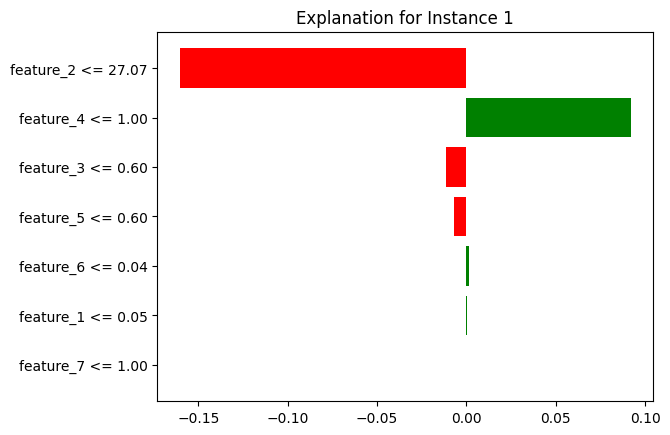

157/157 [==============================] - 0s 2ms/step


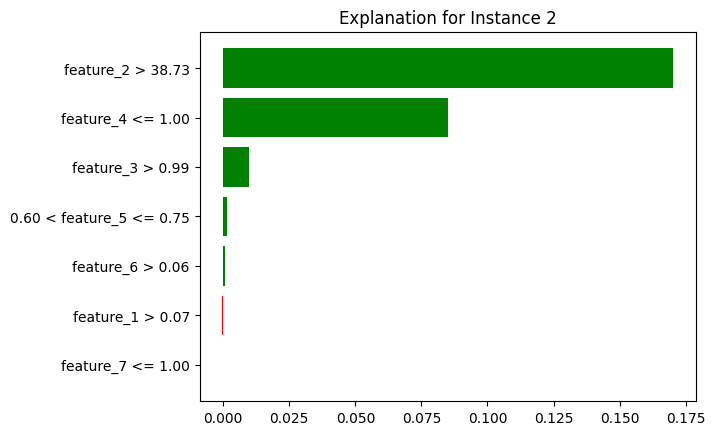

157/157 [==============================] - 0s 2ms/step


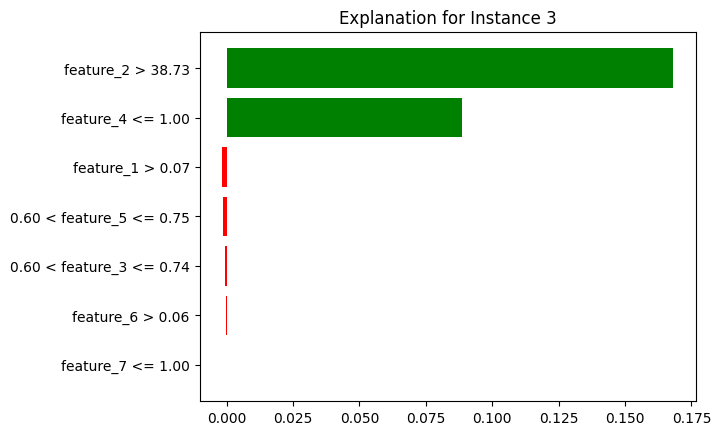

157/157 [==============================] - 0s 2ms/step


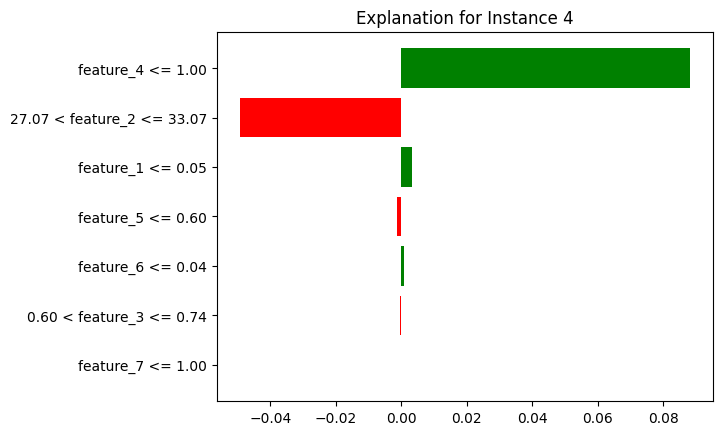

157/157 [==============================] - 0s 2ms/step


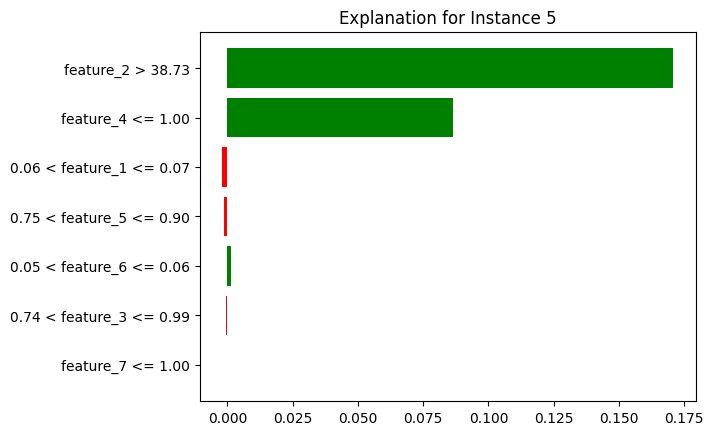

157/157 [==============================] - 0s 2ms/step


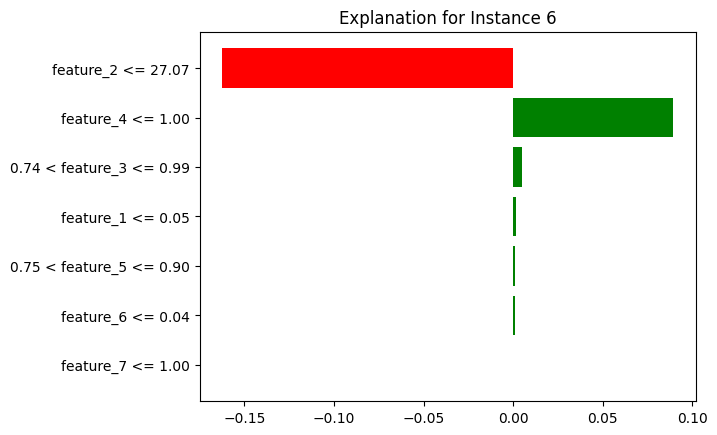

157/157 [==============================] - 0s 2ms/step


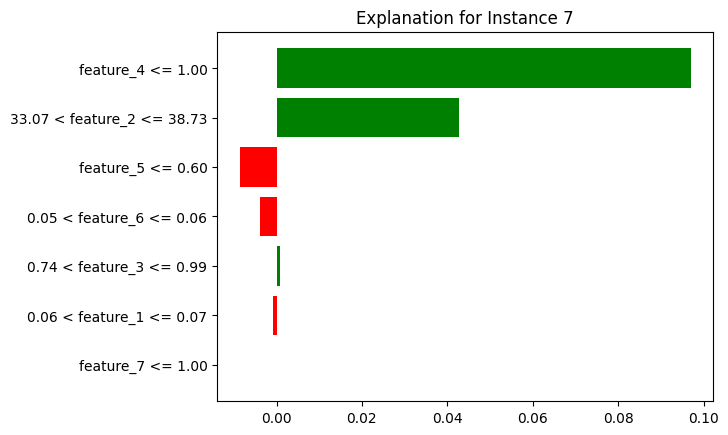

157/157 [==============================] - 0s 2ms/step


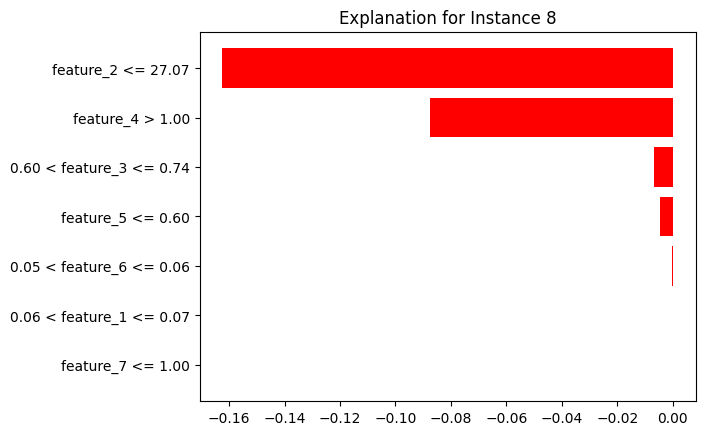

157/157 [==============================] - 0s 2ms/step


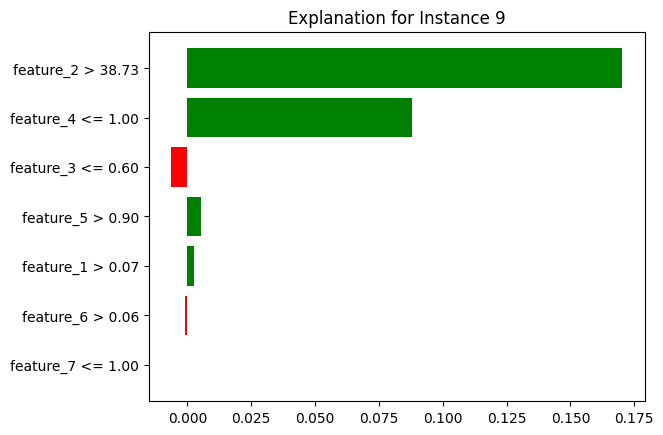

157/157 [==============================] - 0s 2ms/step


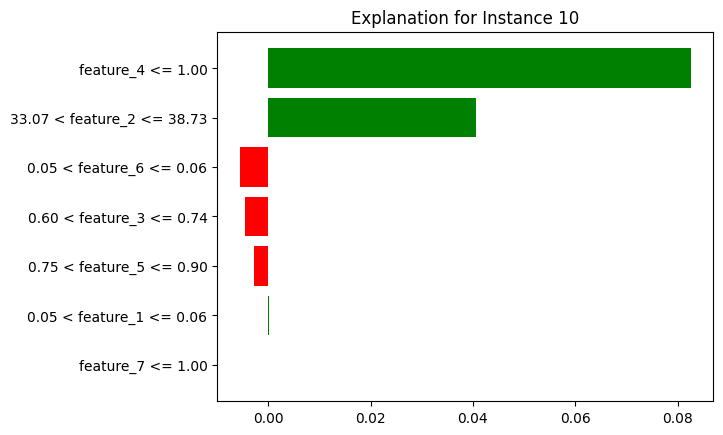

In [456]:
# Initialize the LIME tabular explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    X_train,
    feature_names=[f'feature_{i+1}' for i in range(X_train.shape[1])],  
    class_names=["Yee Ern", "Jason", "Jun Chuan", "Rachel"],
    discretize_continuous=True
)

# Define the prediction function
def predict_fn(features):
    return ga_model.predict(features) 

# Function to explain and visualize the explanation for a single instance
def explain_and_visualize(instance, index):
    # Explain the model's prediction on the selected instance
    explanation = explainer.explain_instance(
        instance,
        predict_fn,  # Use the prediction function of the best model
        num_features=7,  
        top_labels=5  # Number of top labels to explain
    )

    # Display the explanation
    explanation.show_in_notebook(show_all=False)
    explanation.as_pyplot_figure()
    plt.title(f'Explanation for Instance {index + 1}')
    plt.show()

for i in range(min(10, len(X_train))):
    explain_and_visualize(X_train[i], i)

In [3]:
print("Accuracy for class Yee Ern: 0.82")
print("Accuracy for class Jason: 0.78")
print("Accuracy for class Jun Chuan: 0.85")
print("Accuracy for class Rachel: 0.42")
print("Best accuracy: Jun Chuan with 0.85")
print("Worst accuracy: Rachel with 0.42")

Accuracy for class Yee Ern: 0.82
Accuracy for class Jason: 0.78
Accuracy for class Jun Chuan: 0.85
Accuracy for class Rachel: 0.42
Best accuracy: Jun Chuan with 0.85
Worst accuracy: Rachel with 0.42
